Trabalho de Inteligência Computacional <br>
Professor Celso Camilo <br>
Aluno: Felipe Miranda <br>
Matrícula: 201802677

In [23]:
from mpl_toolkits import mplot3d
import numpy as np
import matplotlib.pyplot as plt
import plotly.graph_objects as go

Definindo a Função F6

In [24]:
def F6(x, y):
        #return 0.5 - ((np.power(np.sin(np.sqrt(x**2 + y**2)), 2)- 0.5) / ((1.0 + 1e-3 * np.sqrt(x**2 + y**2))) ** 2)
        num = np.subtract((np.power((np.sin(np.sqrt(np.add((np.power(x, 2)), (np.power(y, 2)))))), (2))), 0.5)
        den = np.power((np.add(1.0, (np.multiply(1e-3, (np.add((np.power(x, 2)), (np.power(y, 2)))))))), 2)
        frac = np.divide(num, den)
        return np.subtract(0.5, frac)

In [25]:

x = np.outer(np.linspace(-10, 10, num = 1000), np.ones(1000))
y = x.copy().T
z = F6(x, y)

Visualizando a Função F6

In [26]:
fig = go.Figure(data=[go.Surface(z=z)])

fig.update_layout(title='F6 function', autosize=False,
                  width=1000, height=800)
                  #margin=dict(l=65, r=50, b=65, t=90))

fig.show()

Testando os métodos que Serão utilizados 

In [27]:
f1 = [np.random.randint(0,2) for i in range(0,44)]
f1 = [0,0,0,0,1,0,1,0,0,0,0,1,1,0,0,0,0,0,0,0,0,1,1,0,0,0,1,0,1,0,1,0,0,0,1,1,1,0,1,1,1,0,1,1]
print(f1)

[0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1]


In [28]:
f1 = np.array(f1)
f1_x = f1[:22]
f1_y = f1[22:]
print(f' Cromossomo x: {f1_x} \n Cromossomo y: {f1_y}')

 Cromossomo x: [0 0 0 0 1 0 1 0 0 0 0 1 1 0 0 0 0 0 0 0 0 1] 
 Cromossomo y: [1 0 0 0 1 0 1 0 1 0 0 0 1 1 1 0 1 1 1 0 1 1]


In [29]:
x = ''
for i in f1_x:
    x = x + str(i)
print(f'Binary X: {x}')

x_decimal = int(x, 2)

print(f'Decimal X: {x_decimal}')

y = ''
for i in f1_y:
    y = y + str(i)
print(f'Binary Y: {y}')

y_decimal = int(y, 2)

print(f'Decimal Y: {y_decimal}')



Binary X: 0000101000011000000001
Decimal X: 165377
Binary Y: 1000101010001110111011
Decimal Y: 2270139


In [30]:
alter_num = lambda i: (i * 200 / (np.power(2, 22) - 1)) -100

x_altered = alter_num(x_decimal)
y_altered = alter_num(y_decimal)

print(f'x alterado: {x_altered} \ny alterado: {y_altered}')

x alterado: -92.11420824866491 
y alterado: 8.248688757106962


In [31]:
F6(x_altered, y_altered)

0.4949292281555556

In [32]:
#mutation_rate = 0.9
mutation_rate = 8e-3
crossover_rate = 0.65
num_generations = 1
pop_size = 100

Definindo a função que realizará a mutação

In [33]:
def mutate(dna, mutation_rate):
    for i in range(len(dna)):
        if mutation_rate > np.random.rand():
            if dna[i] == 1:
                dna[i] = 0
            else:
                dna[i] = 1
    return dna
            

In [34]:
mutated = mutate(f1, mutation_rate)
mutated


array([0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1])

Definindo a função que definirá o Crossover

In [35]:
def crossover(father1, father2, crossover_rate):

    individual1, individual2 = [], []

    if crossover_rate > np.random.rand():

        gene_len = np.random.randint(0, len(father1))
        x1, y1 = father1[:gene_len], father2[gene_len:]
        x2, y2 = father2[:gene_len], father1[gene_len:]
        #print(f'X1: {x1} -  Y1 {y1}')
        #print(f'X2: {x2} - Y2 {y2}')
        individual1.append(x1 + y1)
        individual2.append(x2 + y2)

        return individual1, individual2
    else:
        return [father1], [father2]

In [36]:
crossover([1,2,3,4,5,6,7], [11, 22, 33, 44, 55, 66, 77], crossover_rate = 0.05)

([[1, 2, 3, 4, 5, 6, 7]], [[11, 22, 33, 44, 55, 66, 77]])

Função que inicializa a geração inicial

In [37]:
def create_generation(pop_size):
    generation = []
    for i in range(pop_size): 
        individual = [np.random.randint(0,2) for i in range(0,44)]
        generation.append(individual)
    return generation

Função que avalia a performance "Fitness" de cada indivíduo

In [38]:
def evaluate_individual(individual):
    individual = np.array(individual)
    len_gene = int(len(individual)/2)
    individual_x = individual[:len_gene]
    individual_y = individual[len_gene:]

    x = ''
    for i in individual_x: x = x + str(i)
    x_decimal = int(x, 2)

    y = ''
    for i in individual_y: y = y + str(i)
    y_decimal = int(y, 2)

    x_altered = alter_num(x_decimal)
    y_altered = alter_num(y_decimal)

    return F6(x_altered, y_altered)

In [39]:
evaluate_individual([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

0.9999999988619942

Definindo a selção por Roleta (Roulette Selection)

In [40]:
#Roulette Selection

def roulette_selection(score, gen):

    fitness_sum = np.array(list(score)).sum()
    father1, father2 = [], []

    while father1 == []:
        individual1 = np.random.randint(0, len(score))
        
        if np.random.rand() < (score[individual1] / fitness_sum):
            father1 = gen[individual1]

    while father2 == []:
        individual2 = np.random.randint(0, len(score))
        
        if np.random.rand() < (score[individual2] / fitness_sum):
            father2 = gen[individual2]

    return list(father1), list(father2)

In [41]:
mutation_rate = 8e-3
crossover_rate = 0.65
num_generations = 4000
pop_size = 100

Loop Principal para realizar todo o processo do GA

In [43]:
gen = create_generation(pop_size)
scoreboard = []
for i in range(num_generations):

    score = []
    for individual in gen:
        score.append(evaluate_individual(individual))
    xy = sorted(zip(score,gen), reverse=True) #avalia a população
    score, gen = zip(*xy) 
    
    next_gen = []

    #gen = gen[:100]
    #score = score[:100]
    
    
    while len(next_gen) <= (len(gen)):
        roullete_selected_1, roulette_selected2 = roulette_selection(score, gen)
        
        crossover_selected_1, crossover_selected_2 = crossover(roullete_selected_1, roulette_selected2, crossover_rate)
        if len(next_gen) < len(gen):
            next_gen.extend(crossover_selected_1)
        elif len(next_gen) < len(gen):
            next_gen.extend(crossover_selected_2)
        else:
            break
    
    next_gen = next_gen[:(pop_size - 1)]
    
    if score[0] > 0.999999999:

        print(f'Geração {i}')
        print(f'Melhor score da geração: {score[0]}')
        print(f'Gene: {gen[0]}')
        break
    
    if i % 100 == 0:
        print(f'Geração {i}')
        print(f'Melhor score da geração: {score[0]}')
        print(f'Gene: {gen[0]}')
        
    
    for k in next_gen:
        mutate(k, mutation_rate)
    
    
    next_gen = [gen[0]] + next_gen
    
    gen = next_gen
    
    scoreboard.append(score[0])

    

    


Geração 0
Melhor score da geração: 0.9589592529348625
Gene: [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1]
Geração 100
Melhor score da geração: 0.9999988335445222
Gene: [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0]
Geração 200
Melhor score da geração: 0.9999999988619942
Gene: [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Geração 300
Melhor score da geração: 0.9999999988619942
Gene: [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Geração 400
Melhor score da geração: 0.9999999988619942
Gene: [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Geração 500
Melhor score da

Visualizando "Fitness" por Geração

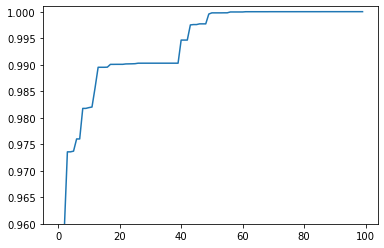

In [47]:
plt.ylim(0.96, 1.001)
plt.plot(scoreboard[:100]);

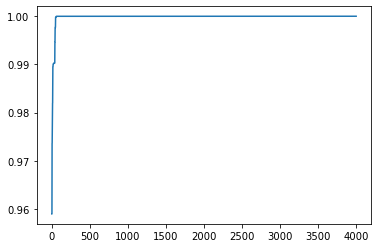

In [49]:
plt.plot(scoreboard);